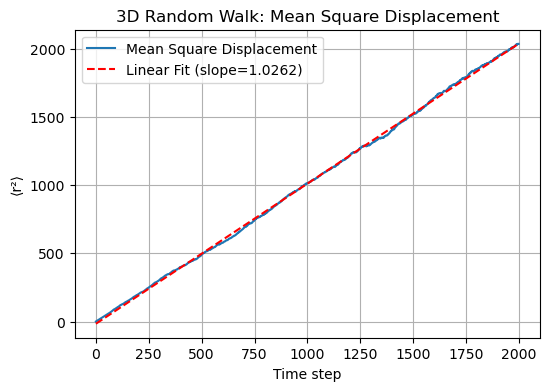

Estimated diffusion constant D ≈ 0.171


Animation size has reached 20983292 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


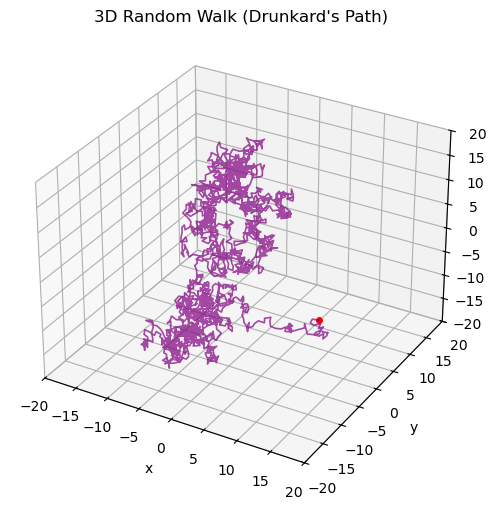

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML
from scipy.stats import linregress

# -----------------------------
# Parameters
# -----------------------------
num_steps = 2000    # total number of steps
step_size = 1.0     # length of each step
num_walks = 1000     # number of random walks for statistics

# -----------------------------
# Function: single random walk
# -----------------------------
def random_walk_3d(num_steps, step_size):
    # Uniform sampling on the sphere
    theta = np.random.uniform(0, 2*np.pi, num_steps)  # azimuthal angle
    phi = np.random.uniform(0, np.pi, num_steps)      # polar angle
    
    dx = step_size * np.sin(phi) * np.cos(theta)
    dy = step_size * np.sin(phi) * np.sin(theta)
    dz = step_size * np.cos(phi)
    
    x = np.cumsum(dx)
    y = np.cumsum(dy)
    z = np.cumsum(dz)
    return x, y, z

# -----------------------------
# Generate multiple walks
# -----------------------------
walks = [random_walk_3d(num_steps, step_size) for _ in range(num_walks)]

# Compute mean square displacement
msd = np.mean([x**2 + y**2 + z**2 for x, y, z in walks], axis=0)

# -----------------------------
# Plot MSD vs time
# -----------------------------
time = np.arange(num_steps)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(time, msd)
linear_fit = slope * time + intercept

plt.figure(figsize=(6, 4))
plt.plot(time, msd, label="Mean Square Displacement")
plt.plot(time, linear_fit, color='red', linestyle='--', label=f'Linear Fit (slope={slope:.4f})')
plt.xlabel("Time step")
plt.ylabel("⟨r²⟩")
plt.title("3D Random Walk: Mean Square Displacement")
plt.grid(True)
plt.legend()
plt.show()

print(f"Estimated diffusion constant D ≈ {slope/6:.3f}")

# -----------------------------
# Animation of a single 3D walk
# -----------------------------
x, y, z = walks[0]

fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(-20, 20)
ax.set_ylim(-20, 20)
ax.set_zlim(-20, 20)
ax.set_title("3D Random Walk (Drunkard's Path)")
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_zlabel("z")

point, = ax.plot([], [], [], 'ro', markersize=4)
trail, = ax.plot([], [], [], lw=1.2, color='purple', alpha=0.7)

def init():
    point.set_data([], [])
    point.set_3d_properties([])
    trail.set_data([], [])
    trail.set_3d_properties([])
    return point, trail

def update(i):
    point.set_data([x[i]], [y[i]])
    point.set_3d_properties([z[i]])
    trail.set_data(x[:i+1], y[:i+1])
    trail.set_3d_properties(z[:i+1])
    return point, trail

ani = FuncAnimation(fig, update, frames=num_steps, init_func=init, blit=True, interval=10)
HTML(ani.to_jshtml())
